In [1]:
library(Seurat)
library(data.table)
library(Matrix)
library(future)
library(dplyr)
library(tidyr)
library(patchwork)
library(ggplot2)
library(ggrepel)
library(grid)
library(Matrix)
library(doParallel)
library(edgeR)
library(harmony)
library(SeuratDisk)
library(spacexr)
library(FNN)
library(precrec)
library(hrbrthemes)
library(glue)
library(gridExtra)

Registered S3 method overwritten by 'spatstat.core':
  method          from
  formula.glmmPQL MASS

Attaching SeuratObject

Warning message:
“package ‘Matrix’ was built under R version 4.1.3”

Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘tidyr’


The following objects are masked from ‘package:Matrix’:

    expand, pack, unpack


Loading required package: foreach

Loading required package: iterators

Loading required package: parallel

Loading required package: limma

Loading required package: Rcpp

Warning message:
“package ‘Rcpp’ was built under R version 4.1.3”
Registered S3 method overwritten by 'SeuratDisk':
  method            from  
  as.sparse.H5Group Seurat

NOTE: Either Arial Narrow or Roboto Condensed fonts are requi

In [1]:
library(Seurat)
library(data.table)
library(Matrix)
library(future)
library(dplyr)
library(tidyr)
library(patchwork)
library(ggplot2)
library(ggrepel)
library(grid)
library(Matrix)
library(doParallel)
library(edgeR)
library(harmony)
library(SeuratDisk)
library(spacexr)
library(FNN)

Registered S3 method overwritten by 'spatstat.core':
  method          from
  formula.glmmPQL MASS

Attaching SeuratObject

Warning message:
“package ‘Matrix’ was built under R version 4.1.3”

Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘tidyr’


The following objects are masked from ‘package:Matrix’:

    expand, pack, unpack


Loading required package: foreach

Loading required package: iterators

Loading required package: parallel

Loading required package: limma

Loading required package: Rcpp

Warning message:
“package ‘Rcpp’ was built under R version 4.1.3”
Registered S3 method overwritten by 'SeuratDisk':
  method            from  
  as.sparse.H5Group Seurat



In [2]:
options(future.globals.maxSize = 32000 * 1024^2)
plan("multicore", workers = 12)
plan()

multicore:
- args: function (..., workers = 12, envir = parent.frame())
- tweaked: TRUE
- call: plan("multicore", workers = 12)

### Preliminary analysis and integration

In [3]:
# Harmony integration
if (file.exists("data/visium_all.rds")) {
    vis.obj <- readRDS("data/visium_all.rds")
} else {
    vis.objs <- list()
    for (slide in c("A_1", "A_2", "B_1", "B_2")) {
        vis.obj <- Load10X_Spatial(data.dir = paste0("data/visium/CHL_", slide), slice=slide)        
        vis.obj[['slide']] = slide
        vis.obj[['orig.ident']] = slide
        vis.obj <- subset(vis.obj, subset = nCount_Spatial > 200 & nFeature_Spatial > 100)
        vis.obj <- SCTransform(vis.obj, assay = "Spatial", verbose = FALSE)
        vis.objs[[slide]] <- vis.obj
    }

    vis.obj <- merge(vis.objs[[1]], y = c(vis.objs[[2]], vis.objs[[3]], vis.objs[[4]]), 
                      add.cell.ids = c("A_1", "A_2", "B_1", "B_2"), project = "cHL_spatial")
    
    print(dim(vis.obj))    
    DefaultAssay(vis.obj) <- "SCT"
    VariableFeatures(vis.obj) <- c(VariableFeatures(vis.objs[[1]]), 
                                   VariableFeatures(vis.objs[[2]]),
                                   VariableFeatures(vis.objs[[3]]),
                                   VariableFeatures(vis.objs[[4]]))
    
    vis.obj <- RunPCA(vis.obj, npcs = 50)
    vis.obj <- RunHarmony(vis.obj, "slide", assay.use="SCT")
    vis.obj <- RunUMAP(vis.obj, reduction='harmony', dims = 1:50)
    vis.obj <- RunTSNE(vis.obj, reduction='harmony', dims = 1:50)
    vis.obj <- FindNeighbors(vis.obj, reduction='harmony')
    vis.obj <- FindClusters(vis.obj, resolution = 0.5)
    
    markers <- read.csv("data/hrs_markers.csv")
    markers <- markers$x[markers$x %in% rownames(vis.obj@assays$Spatial@counts)]
    markers <- c(markers, 'NFKBIA', 'STAT5A', 'IL6', 'CDKN1A', 'IER3','CD274')
    vis.obj@meta.data$hrs.markers.sum <- colSums(vis.obj@assays$Spatial@counts[markers, ])
    vis.obj <- AddModuleScore(vis.obj, features = list(markers), name = 'hrs.markers')
    
    saveRDS(vis.obj, "data/visium_all.rds")
}
vis.obj

An object of class Seurat 
35758 features across 12771 samples within 3 assays 
Active assay: SCT (17800 features, 12000 variable features)
 2 other assays present: Spatial, prediction.score.cell_types_level_3
 6 dimensional reductions calculated: pca, harmony, umap, tsne, ref.pca, ref.umap
 4 images present: A_1, A_2, B_1, B_2

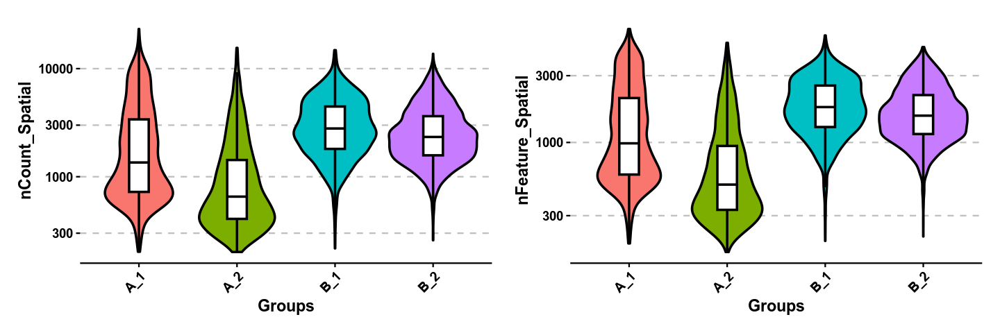

In [5]:
options(repr.plot.width=12, repr.plot.height=4)
p1 <- SCpubr::do_ViolinPlot(
    sample = vis.obj, feature = c("nCount_Spatial"), group.by = "slide") + scale_y_continuous(trans='log10')
p2 <- SCpubr::do_ViolinPlot(
    sample = vis.obj, feature = c("nFeature_Spatial"), group.by = "slide") + scale_y_continuous(trans='log10')
p1 | p2

In [ ]:
vis.obj <- RunUMAP(
    vis.obj, reduction='harmony', 
    dims = 1:30, spread=5, min.dist = 0.01, learning.rate=10, n.neighbors = 50L, n.epochs=2000
)

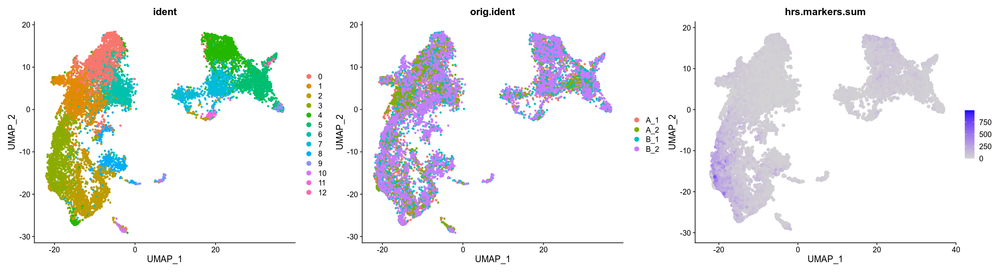

In [223]:
options(repr.plot.width=22, repr.plot.height=6)
p1 <- DimPlot(vis.obj, reduction = "umap", group.by = c("ident"), pt.size=1)
p2 <- DimPlot(vis.obj, reduction = "umap", group.by = c("orig.ident"), pt.size=1)
p3 <- FeaturePlot(vis.obj, features = c("hrs.markers.sum"), pt.size=2)
p1 | p2 | p3

In [ ]:
vis.obj <- PrepSCTFindMarkers(vis.obj)
vis.obj.markers <- FindAllMarkers(vis.obj, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

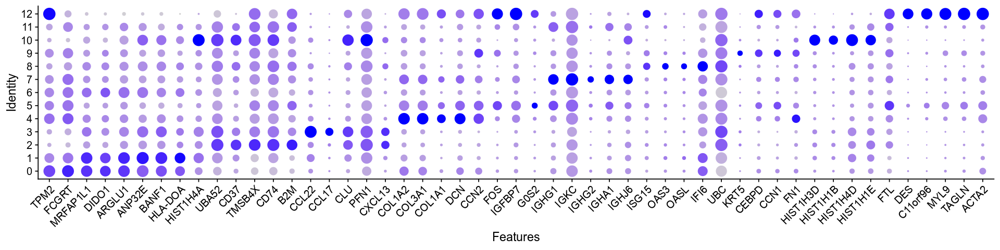

In [199]:
options(repr.plot.width=16, repr.plot.height=4)
vis.obj.markers %>%
    group_by(cluster) %>%
    top_n(n = 5, wt = avg_log2FC) -> top10
DotPlot(vis.obj, features = unique(top10$gene)) + NoLegend() + RotatedAxis()

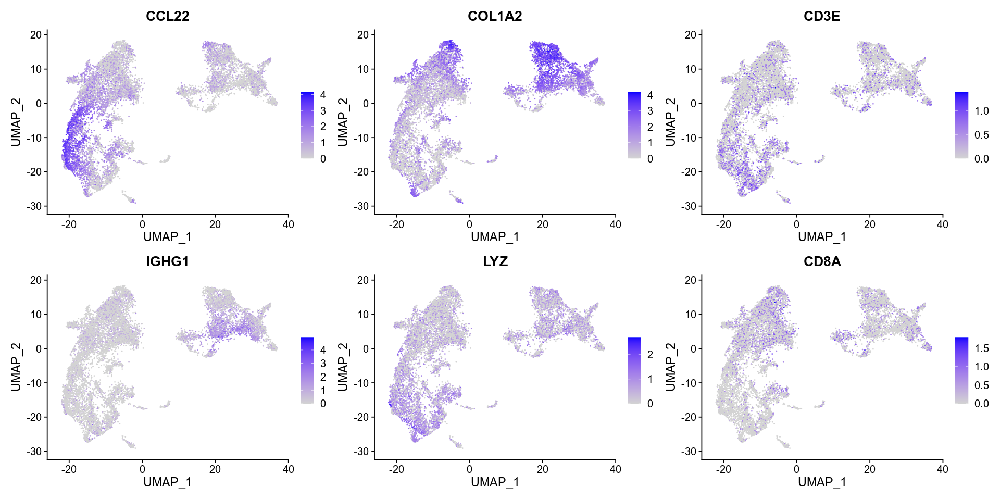

In [196]:
options(repr.plot.width=16, repr.plot.height=8)
FeaturePlot(vis.obj, features = c("CCL22", "COL1A2", "CD3E", "IGHG1", "LYZ", "CD8A"), ncol=3)

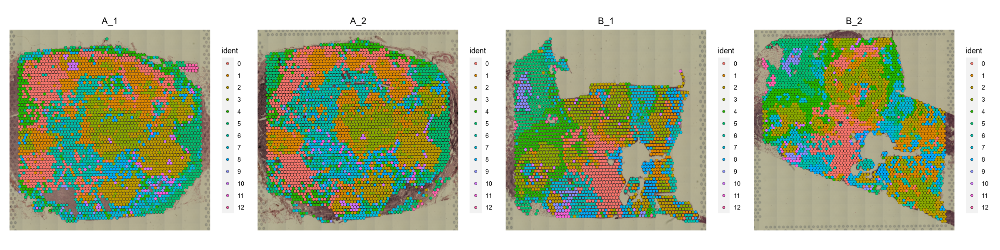

In [224]:
options(repr.plot.width=20, repr.plot.height=5)
SpatialDimPlot(vis.obj, ncol=4)

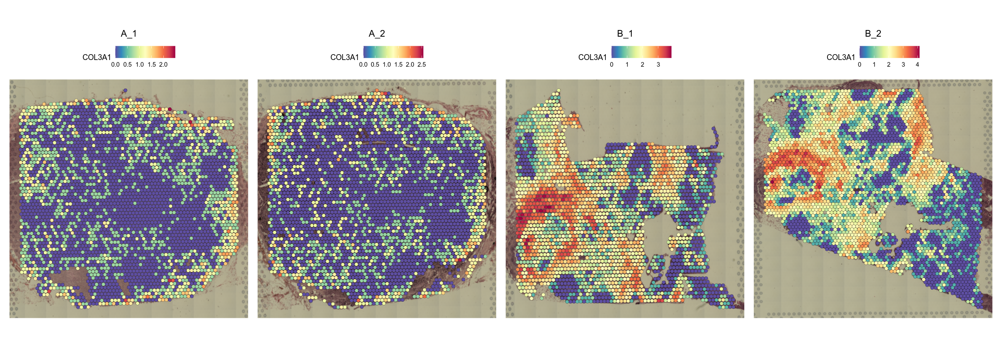

In [162]:
options(repr.plot.width=20, repr.plot.height=7)
SpatialFeaturePlot(vis.obj, ncol=4, features="COL3A1")

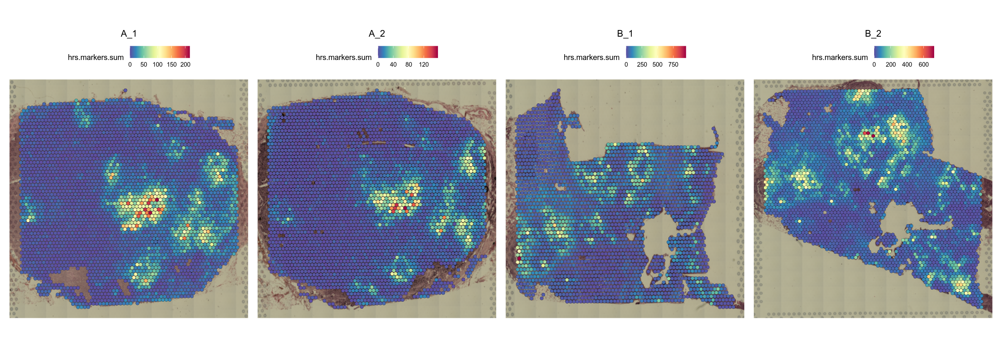

In [169]:
options(repr.plot.width=20, repr.plot.height=7)
SpatialFeaturePlot(vis.obj, ncol=4, features="hrs.markers.sum")

### Seurat Reference mapping

In [ ]:
reference <- LoadH5Seurat(
    "/home/dchafamo/cHL_singlecell/data/single_cell_objects/combined_dataset_final_annotated_postqc_harmonized1.h5Seurat"
)

Idents(reference) <- "cell_types_level_3"
reference <- subset(reference, downsample = 3000)
reference <- SCTransform(reference, assay = "cellbender_corrected", clip.range = c(-10, 10), verbose = FALSE)
reference <- RunUMAP(reference, reduction='harmony', dims = 1:50, verbose = FALSE, return.model=TRUE)

transfer_anchors <- FindTransferAnchors(
    reference = reference,
    query = vis.obj,
    normalization.method = "SCT",
    reference.reduction = "pca",
    recompute.residuals = FALSE,
    dims = 1:50
)

vis.obj <- MapQuery(
  anchorset = transfer_anchors,
  query = vis.obj,
  reference = reference,
  refdata = list(
    cell_types_level_3 = "cell_types_level_3"
  ),
  reference.reduction = "pca",
  reduction.model = "umap"
)

Idents(vis.obj) <- "predicted.cell_types_level_3"
reference$id <- 'reference'
vis.obj$id <- 'query'
refquery <- merge(reference, vis.obj)
refquery[["umap"]] <- merge(reference[["umap"]], vis.obj[["ref.umap"]])

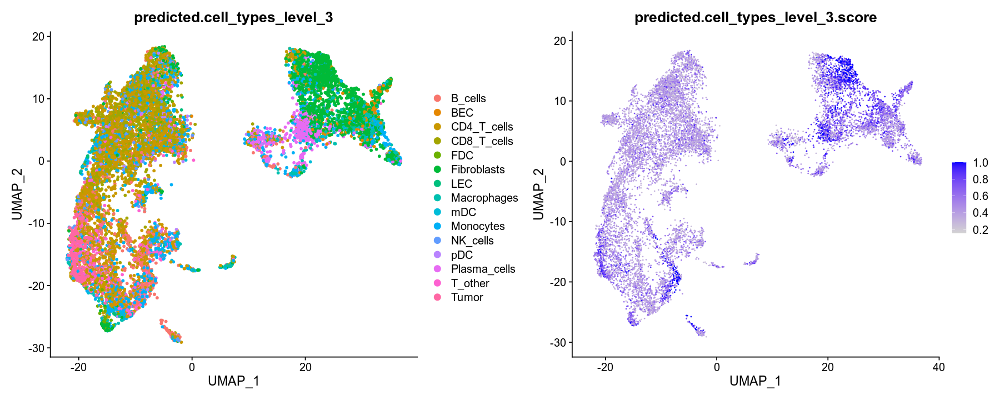

In [182]:
options(repr.plot.width=15, repr.plot.height=6)
p1 <- DimPlot(vis.obj, reduction = "umap", group.by = c("predicted.cell_types_level_3"), pt.size=1)
p2 <- FeaturePlot(vis.obj, features = c("predicted.cell_types_level_3.score")) # prediction confidence
p1 | p2

In [ ]:
Idents(vis.obj) <- 'predicted.cell_types_level_3'
de <- FindAllMarkers(vis.obj, logfc.threshold = 0)

Warning message:
“Removed 7867 rows containing missing values (`geom_text_repel()`).”
Warning message:
“ggrepel: 110 unlabeled data points (too many overlaps). Consider increasing max.overlaps”


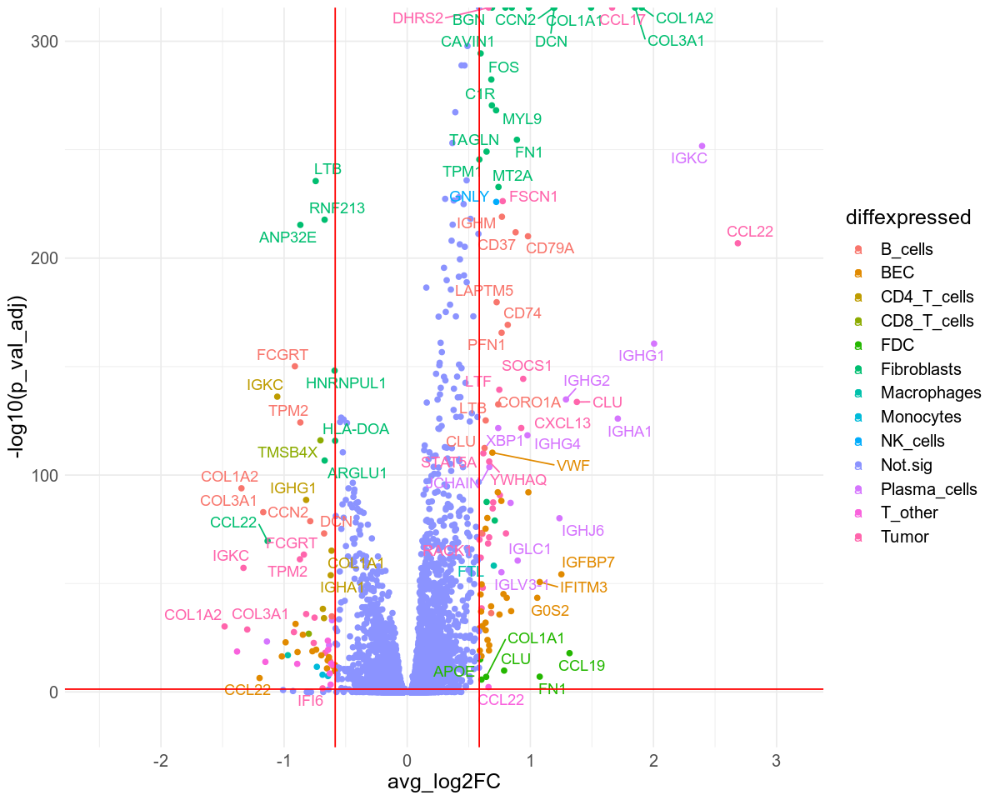

In [292]:
de$diffexpressed <- "Not.sig"
de$diffexpressed[de$p_val_adj < 0.05 & de$avg_log2FC > 0.585] <-  as.character(de$cluster[de$p_val_adj < 0.05 & de$avg_log2FC > 0.585])
de$diffexpressed[de$p_val_adj < 0.05 & de$avg_log2FC < -0.585] <-  as.character(de$cluster[de$p_val_adj < 0.05 & de$avg_log2FC < -0.585])

de$delabel <- NA
de$delabel[de$diffexpressed != "Not.sig"] <- de$gene[de$diffexpressed != "Not.sig"]

options(repr.plot.width=10, repr.plot.height=8)
ggplot(data=de, aes(x=avg_log2FC, y=-log10(p_val_adj), col=diffexpressed, label=delabel)) + 
    geom_point() + theme_minimal() + geom_text_repel() +
    xlim(-2.5,3.1) + ylim(-10,300) + theme(text = element_text(size = 15)) +
    geom_vline(xintercept=c(-0.585, 0.585), col="red") +
    geom_hline(yintercept=-log10(0.05), col="red")

### RCTD

In [ ]:
single_cell_ref <- LoadH5Seurat(
    "~/cHL_singlecell/data/single_cell_objects/combined_dataset_final_annotated_postqc_harmonized1.h5Seurat"
)

In [ ]:
if(!file.exists('data/RCTD_visium_chl_full.rds')) {
    counts <- vis.obj@assays$Spatial@counts
    nUMI <- colSums(counts) 
    puck <- SpatialRNA(NULL, counts, nUMI, use_fake_coords=TRUE)
    barcodes <- colnames(puck@counts)  

    counts <- single_cell_ref@assays$cellbender_corrected@counts
    cell_types <- setNames(single_cell_ref@meta.data$cell_types_level_3, colnames(single_cell_ref))
    cell_types <- as.factor(cell_types)
    nUMI <- colSums(counts)
    rctd.reference <- Reference(counts, cell_types, nUMI)
    myRCTD <- create.RCTD(puck, rctd.reference, UMI_min = 5, UMI_min_sigma = 5, max_cores = 32)
    myRCTD <- run.RCTD(myRCTD, doublet_mode = 'full')
    saveRDS(myRCTD, 'data/RCTD_visium_chl_full.rds')
}

In [175]:
doublet.RCTD <- readRDS('data/RCTD_visium_chl.rds')
full.RCTD <- readRDS('data/RCTD_visium_chl_full.rds')

In [176]:
vis.obj <- AddMetaData(
    vis.obj, 
    metadata = cbind(doublet.RCTD@results$results_df[rownames(vis.obj@meta.data),], 
                     as.data.frame(full.RCTD@results$weights)[rownames(vis.obj@meta.data),], 
                     vis.obj@meta.data
    )
)

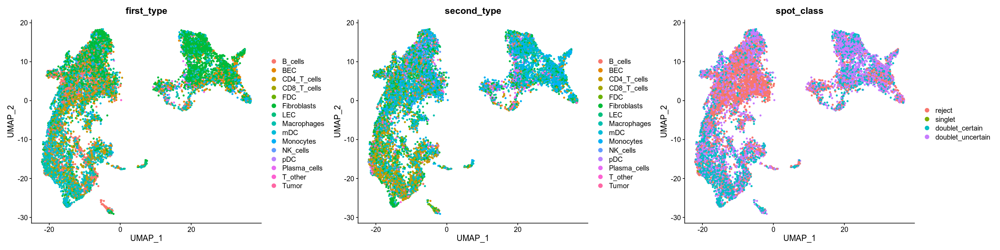

In [185]:
options(repr.plot.width=24, repr.plot.height=6)
DimPlot(vis.obj, reduction = "umap", group.by = c("first_type", "second_type", "spot_class"), pt.size=1)

In [220]:
table(vis.obj@meta.data$first_type, vis.obj@meta.data$slide)

              
                A_1  A_2  B_1  B_2
  B_cells      1040 1253   55   73
  BEC           374  345  224  202
  CD4_T_cells   143  218  223  392
  CD8_T_cells    10   29    6   10
  FDC            13   62   23   76
  Fibroblasts   244  358  920 1179
  LEC           303  354   86  152
  Macrophages   666  370  385  487
  mDC           483  309  272  378
  Monocytes      17   34  221  230
  NK_cells        4    5    6   11
  pDC             3    3    0    3
  Plasma_cells  291  172    9   16
  T_other         7    0    1    1
  Tumor           0    0    4   16

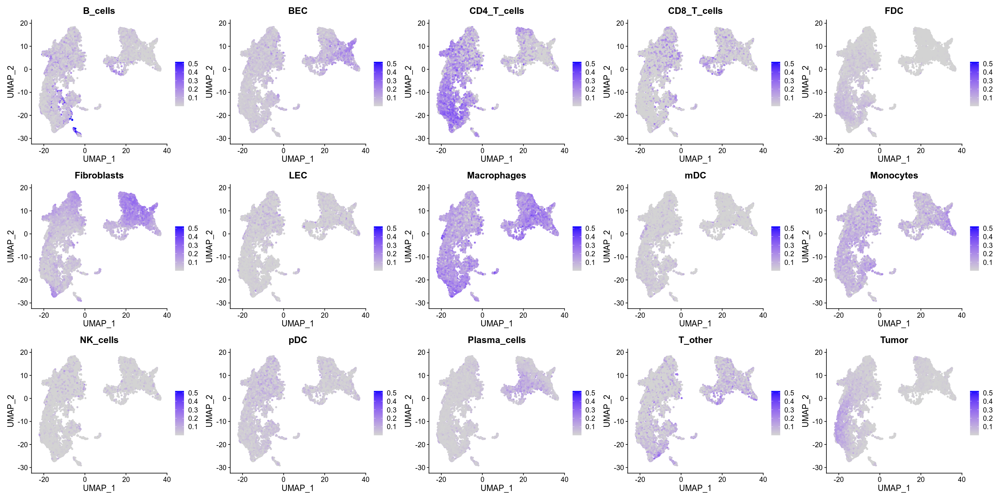

In [235]:
options(repr.plot.width=24, repr.plot.height=12)
FeaturePlot(vis.obj, features = as.data.table(table(vis.obj[['first_type']]))$V1, ncol=5, pt.size=1, keep.scale='all', max.cutoff='q99')

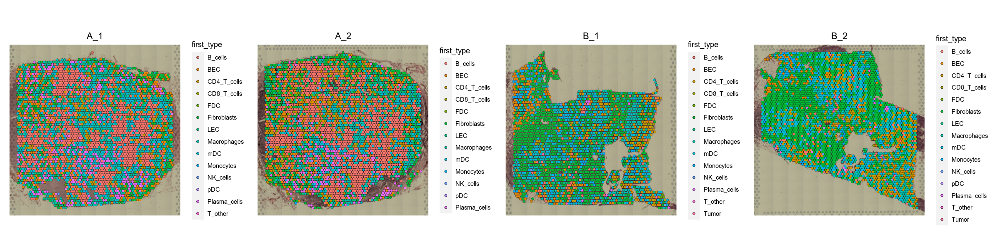

In [248]:
options(repr.plot.width=20, repr.plot.height=5)
SpatialDimPlot(vis.obj, ncol=4, group.by='first_type')

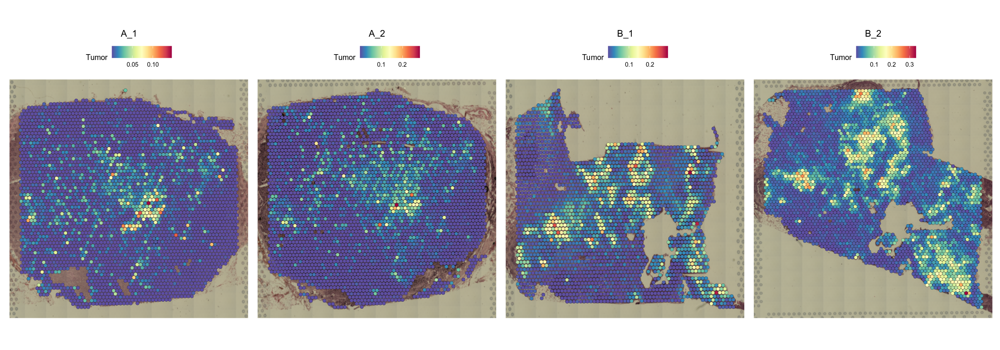

In [244]:
options(repr.plot.width=20, repr.plot.height=7)
SpatialFeaturePlot(vis.obj, ncol=4, features="Tumor")

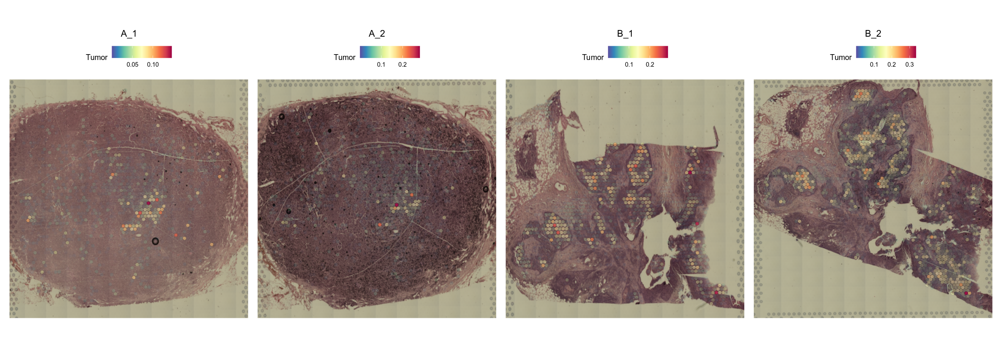

In [277]:
options(repr.plot.width=20, repr.plot.height=7)
SpatialFeaturePlot(vis.obj, ncol=4, features="Tumor", alpha=c(0,0.8))

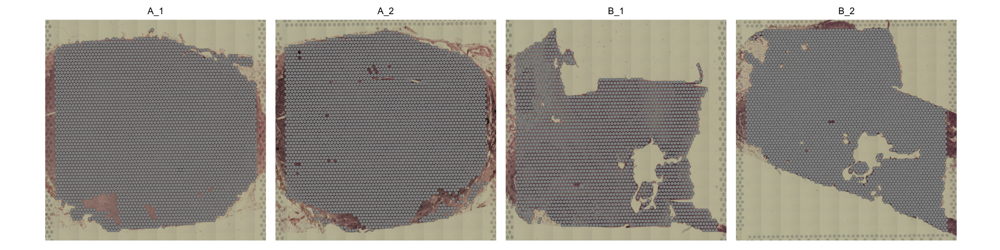

In [8]:
options(repr.plot.width=20, repr.plot.height=5)
SpatialDimPlot(vis.obj, ncol=4, group.by='first_type', images='B_1')

In [7]:
SpatialDimPlot

function (object, group.by = NULL, images = NULL, cols = NULL, 
    crop = TRUE, cells.highlight = NULL, cols.highlight = c("#DE2D26", 
        "grey50"), facet.highlight = FALSE, label = FALSE, label.size = 7, 
    label.color = "white", repel = FALSE, ncol = NULL, combine = TRUE, 
    pt.size.factor = 1.6, alpha = c(1, 1), image.alpha = 1, stroke = 0.25, 
    label.box = TRUE, interactive = FALSE, information = NULL) 
{
    return(SpatialPlot(object = object, group.by = group.by, 
        images = images, cols = cols, crop = crop, cells.highlight = cells.highlight, 
        cols.highlight = cols.highlight, facet.highlight = facet.highlight, 
        label = label, label.size = label.size, label.color = label.color, 
        repel = repel, ncol = ncol, combine = combine, pt.size.factor = pt.size.factor, 
        alpha = alpha, image.alpha = image.alpha, stroke = stroke, 
        label.box = label.box, interactive = interactive, information = information))
}
<bytecode: 0x55fb0691b0d8>
<environment: namespace:Seurat>

### Validation of Tumor annotation

data/CHL_A_1_tumor_annotations.txt


|modnames |dsids |      aucs|   ustats|
|:--------|:-----|---------:|--------:|
|m1       |1     | 0.8423963| 488169.5|


Coordinate system already present. Adding new coordinate system, which will replace the existing one.


data/CHL_A_2_tumor_annotations.txt


|modnames |dsids |      aucs|   ustats|
|:--------|:-----|---------:|--------:|
|m1       |1     | 0.8028219| 564132.5|


Coordinate system already present. Adding new coordinate system, which will replace the existing one.


data/CHL_B_1_tumor_annotations.txt


|modnames |dsids |     aucs| ustats|
|:--------|:-----|--------:|------:|
|m1       |1     | 0.945227| 570350|


Coordinate system already present. Adding new coordinate system, which will replace the existing one.


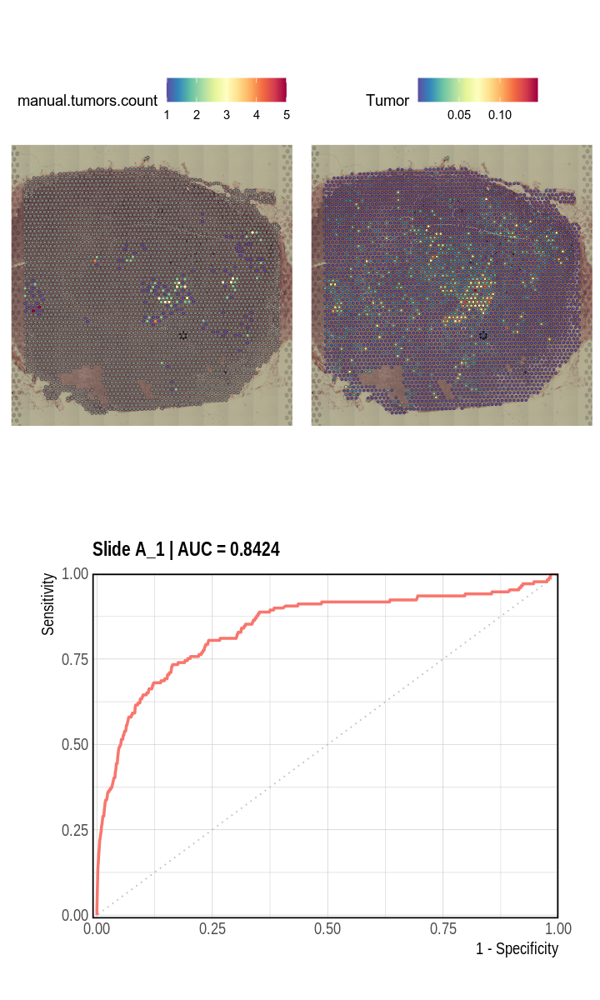

data/CHL_B_2_tumor_annotations.txt


|modnames |dsids |      aucs|  ustats|
|:--------|:-----|---------:|-------:|
|m1       |1     | 0.9256933| 1010235|


Coordinate system already present. Adding new coordinate system, which will replace the existing one.


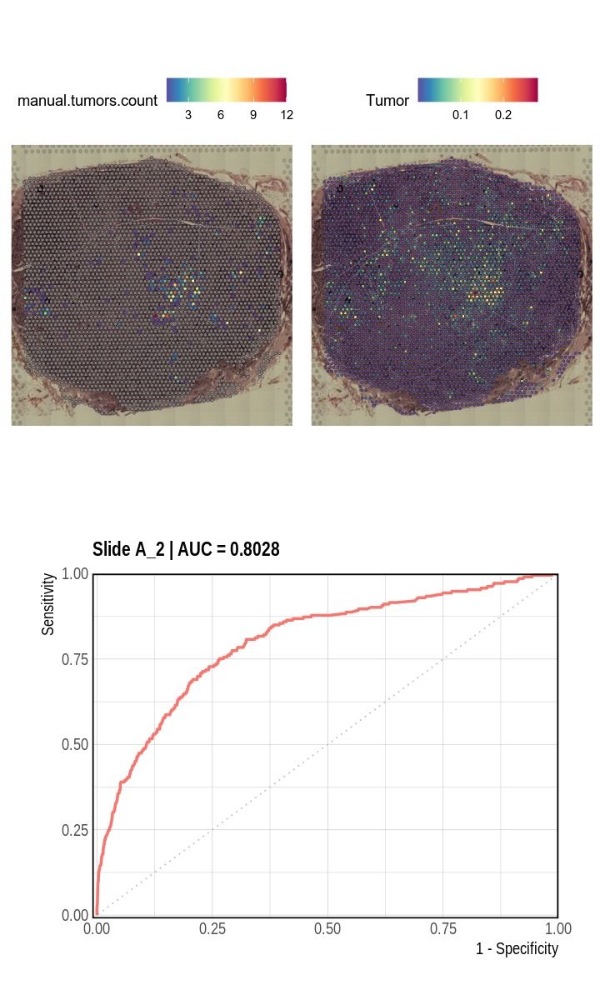

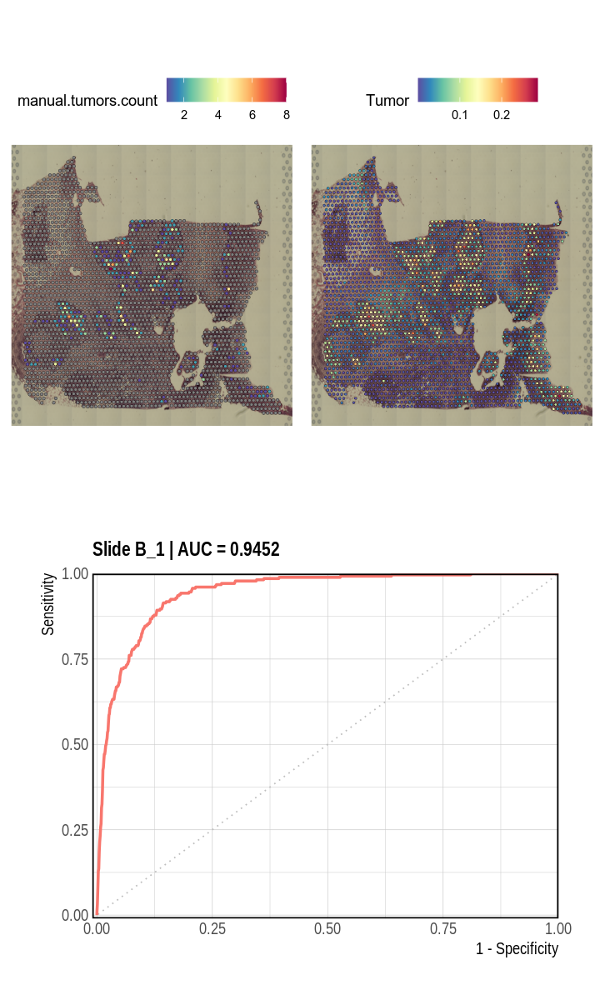

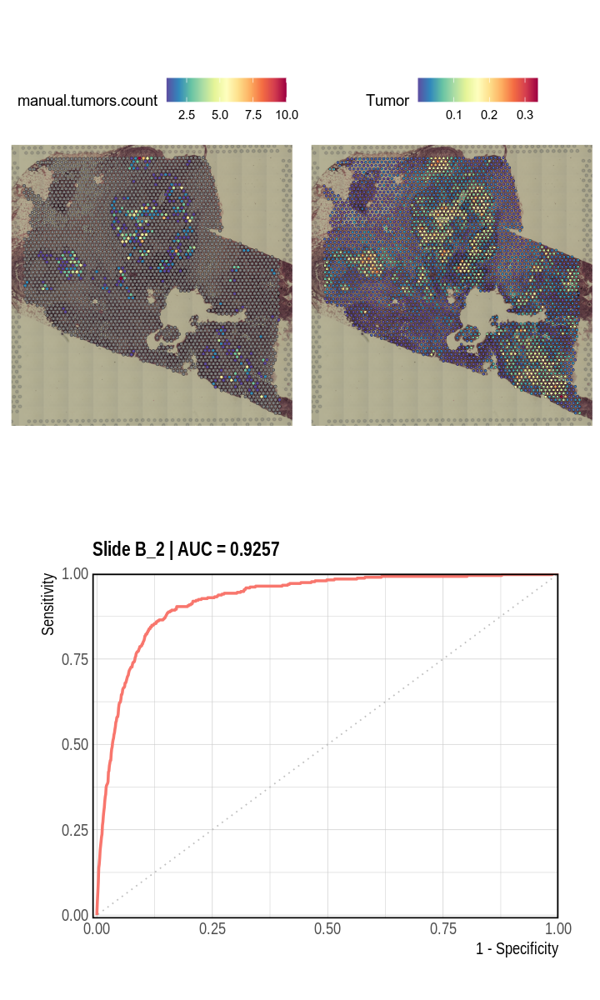

In [106]:
for (key in c("A_1","A_2","B_1","B_2")) {
    annot.file <- glue('data/CHL_{key}_tumor_annotations.txt')
    print(annot.file)

    scale <- 0.4915
    annots <- read.csv(annot.file, sep='\t')[c('Centroid.X.µm', 'Centroid.Y.µm')] / scale
    g = get.knnx(vis.obj@images[[key]]@coordinates[c('imagecol', 'imagerow')], annots, k=1)
    
    tum.index <- as.data.frame(table(g$nn.index))
    rownames(tum.index) <- rownames(vis.obj@images[[key]]@coordinates[as.numeric(levels(tum.index$Var1)),])
    colnames(tum.index) <- c('idx', 'manual.tumors.count')
    vis.obj <- AddMetaData(vis.obj, metadata = tum.index['manual.tumors.count'])
    
    vis.obj[['manual.tumors']] <- as.character(!is.na(vis.obj[['manual.tumors.count']]))
    
    options(repr.plot.width=8, repr.plot.height=8)
    p1 <- SpatialFeaturePlot(vis.obj, ncol=1, features="manual.tumors.count", pt.size.factor = 1.2, images=key)
    ggsave(glue("results/vis_{key}_manual.png"), plot = p1, width = 12, height = 10, dpi = 300, units = "cm")
    
    options(repr.plot.width=8, repr.plot.height=8)
    p2 <- SpatialFeaturePlot(vis.obj, ncol=1, features="Tumor", images=key, pt.size.factor = 1)
    ggsave(glue("results/vis_{key}_RCTD_Tumor.png"), plot = p2, width = 10, height = 10, dpi = 300, units = "cm")
    
    scores <- vis.obj@meta.data[vis.obj@meta.data$orig.ident == key, 'Tumor']
    labels <- vis.obj@meta.data[vis.obj@meta.data$orig.ident == key, 'manual.tumors']
    
    sscurves <- evalmod(scores = scores, labels = labels)
    
    aucs <- evalmod(scores = scores, labels = labels, mode = 'aucroc')
    aucs.df <- as.data.frame(aucs)
    print(knitr::kable(aucs.df))
    
    options(repr.plot.width=8, repr.plot.height=8)
    p3 <- autoplot(sscurves, 'ROC') + theme_linedraw() + geom_line(linewidth=1) + 
        theme_ipsum(base_size=12, axis_title_size=12) + 
        coord_cartesian(xlim = c(-0.01, 1), ylim = c(-0.01, 1), expand = FALSE) +
        theme(
          plot.title = element_text(size=14), 
          panel.border = element_rect(colour = "black", fill=NA, size=1),
          legend.position = "none"
        ) + ggtitle(glue("Slide {key} | AUC = {round(aucs.df$aucs,4)}"))
    ggsave(glue("results/vis_{key}_ROC.png"), plot = p3, width = 12, height = 12, dpi = 300, units = "cm", bg = 'white')
    
    options(repr.plot.width=6, repr.plot.height=10)
    layout <- matrix(c(1,2,3,3), ncol = 2, byrow = TRUE)

    p4 <- grid.arrange(p1, p2, p3, layout_matrix = layout)
}


### Save

In [29]:
vis.obj <- AddMetaData(
    vis.obj, 
    metadata = rbind(
        vis.obj@images$A_1@coordinates,
        vis.obj@images$A_2@coordinates,
        vis.obj@images$B_1@coordinates,
        vis.obj@images$B_2@coordinates
    )
)

In [ ]:
saveRDS(vis.obj, "data/visium_all.rds")
SaveH5Seurat(vis.obj, "data/visium_all.h5Seurat", overwrite = TRUE)

In [ ]:
Convert("data/visium_all.h5Seurat", dest = "h5ad", overwrite=TRUE)

In [242]:
sessionInfo()

R version 4.1.2 (2021-11-01)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: Debian GNU/Linux 11 (bullseye)

Matrix products: default
BLAS/LAPACK: /home/dchafamo/anaconda3/envs/muscat2/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=C.UTF-8       LC_NUMERIC=C           LC_TIME=C.UTF-8       
 [4] LC_COLLATE=C.UTF-8     LC_MONETARY=C.UTF-8    LC_MESSAGES=C.UTF-8   
 [7] LC_PAPER=C.UTF-8       LC_NAME=C              LC_ADDRESS=C          
[10] LC_TELEPHONE=C         LC_MEASUREMENT=C.UTF-8 LC_IDENTIFICATION=C   

attached base packages:
[1] parallel  grid      stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] spacexr_2.0.7         SeuratDisk_0.0.0.9020 harmony_0.1.1        
 [4] Rcpp_1.0.9            edgeR_3.36.0          limma_3.50.3         
 [7] FNN_1.1.3.1           doParallel_1.0.17     iterators_1.0.14     
[10] foreach_1.5.2         ggrepel_0.9.2         ggplot2_3.4.0        
[13] patchwork_1.1.2       tidyr_1.2.1  